# Analiza obrazu - detekcja twarzy

In [40]:
import time

import cv2
from google.colab.patches import cv2_imshow

import dlib

## Inicjalizacja - pobranie obrazu testowego i modeli dla detektorów twarzy

In [41]:
# https://drive.google.com/file/d/1gn7itC80mnmp9TSK8PHMEZSKMOuBVUEQ/view?usp=sharing
!gdown --id 1gn7itC80mnmp9TSK8PHMEZSKMOuBVUEQ

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1gn7itC80mnmp9TSK8PHMEZSKMOuBVUEQ
To: /content/2_Demonstration_Demonstration_Or_Protest_2_1.jpg
100% 147k/147k [00:00<00:00, 58.6MB/s]


In [42]:
# https://drive.google.com/file/d/1UoFK0Jl7tY1z0ykdlvaxkFmyUR8lmLul/view?usp=sharing
!gdown --id 1UoFK0Jl7tY1z0ykdlvaxkFmyUR8lmLul

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1UoFK0Jl7tY1z0ykdlvaxkFmyUR8lmLul
To: /content/haarcascade_frontalface_default.xml
100% 930k/930k [00:00<00:00, 144MB/s]


In [43]:
# https://drive.google.com/file/d/1tb4P8NEcwTnja182AFDDnXM5ijTNQwj_/view?usp=sharing
!gdown --id 1tb4P8NEcwTnja182AFDDnXM5ijTNQwj_

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1tb4P8NEcwTnja182AFDDnXM5ijTNQwj_
To: /content/mmod_human_face_detector.dat
100% 730k/730k [00:00<00:00, 144MB/s]


# Obraz testowy

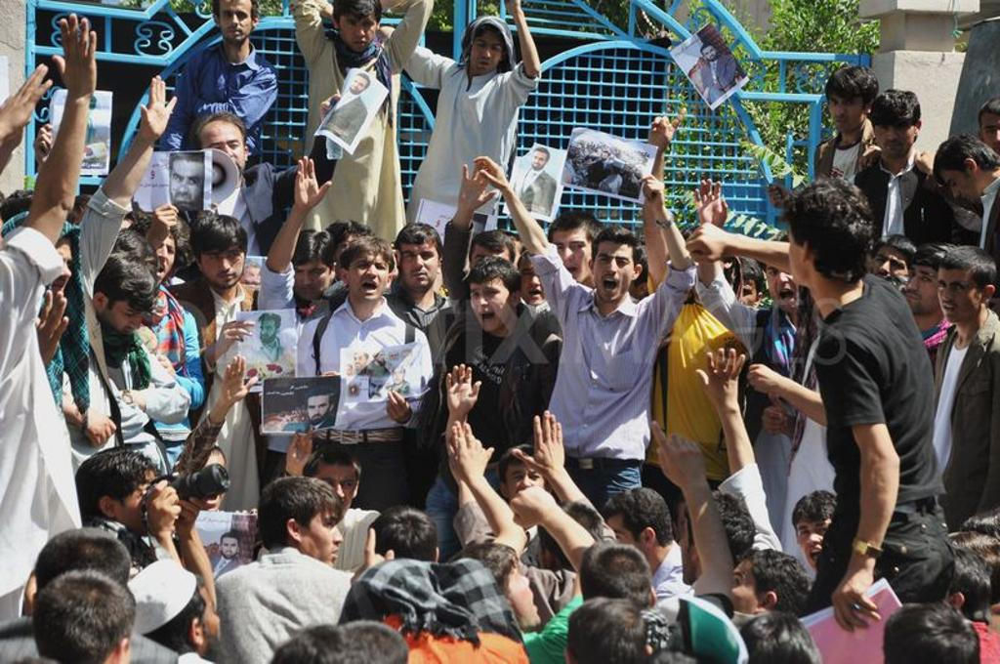

In [44]:
img = cv2.imread("2_Demonstration_Demonstration_Or_Protest_2_1.jpg")
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

cv2_imshow(img)

## Kaskada Haara

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/05/opencv-face-detection-with-haar-cascades/

In [45]:
haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")

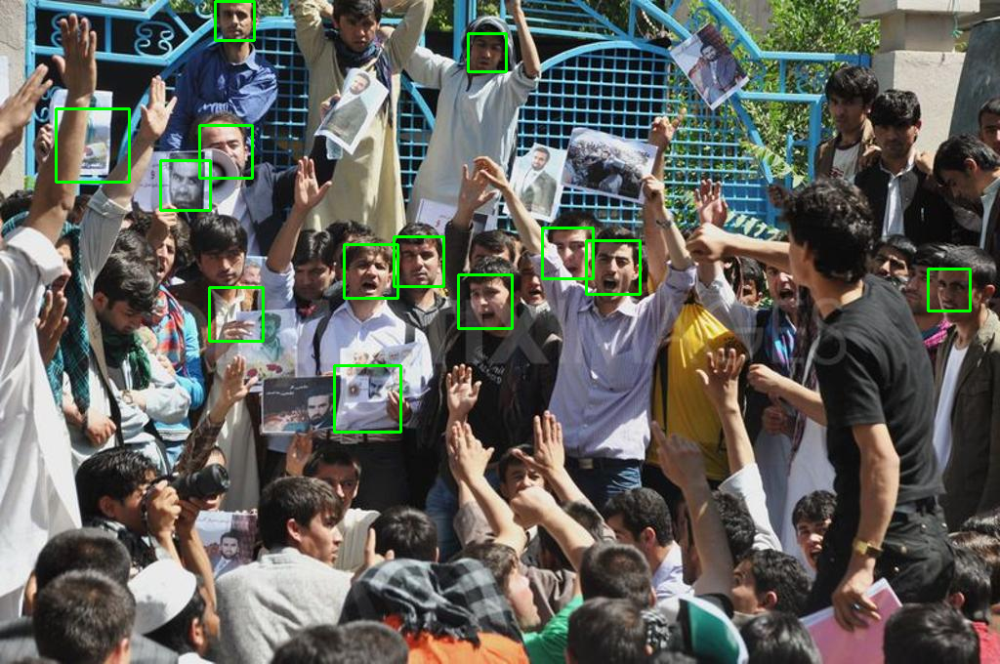

In [46]:
rects = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05,
	                                minNeighbors=5, minSize=(30, 30),
	                                flags=cv2.CASCADE_SCALE_IMAGE)

img_haar = img.copy()
for (x, y, w, h) in rects:
  cv2.rectangle(img_haar, (x, y), (x + w, y + h), (0, 255, 0), 2)
cv2_imshow(img_haar)


## Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [47]:
def convert_and_trim_bb(image, rect):
	# extract the starting and ending (x, y)-coordinates of the
	# bounding box
	startX = rect.left()
	startY = rect.top()
	endX = rect.right()
	endY = rect.bottom()
	# ensure the bounding box coordinates fall within the spatial
	# dimensions of the image
	startX = max(0, startX)
	startY = max(0, startY)
	endX = min(endX, image.shape[1])
	endY = min(endY, image.shape[0])
	# compute the width and height of the bounding box
	w = endX - startX
	h = endY - startY
	# return our bounding box coordinates
	return (startX, startY, w, h)

In [48]:
hog_svm_detector = dlib.get_frontal_face_detector()

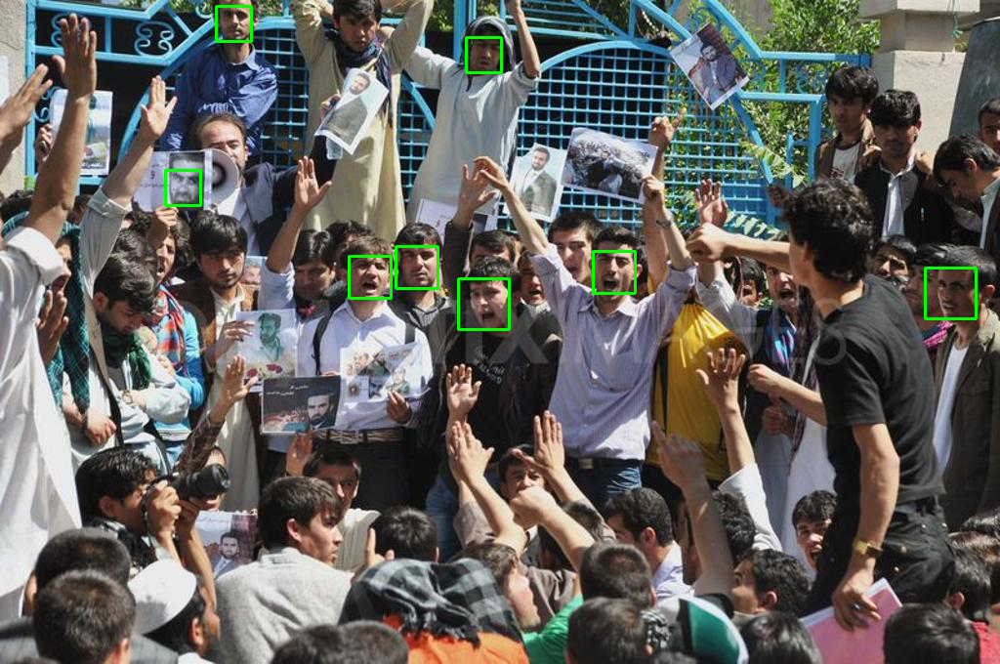

In [49]:
hog_svm_rects = hog_svm_detector(img_rgb, 1)

hog_svm_boxes = [convert_and_trim_bb(img, r) for r in hog_svm_rects]

img_hog_svm = img.copy()
for (x, y, w, h) in hog_svm_boxes:
	cv2.rectangle(img_hog_svm, (x, y), (x + w, y + h), (0, 255, 0), 2)
 
cv2_imshow(img_hog_svm)

## Splotowa sieć neuronowa (CNN)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [50]:
cnn_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')

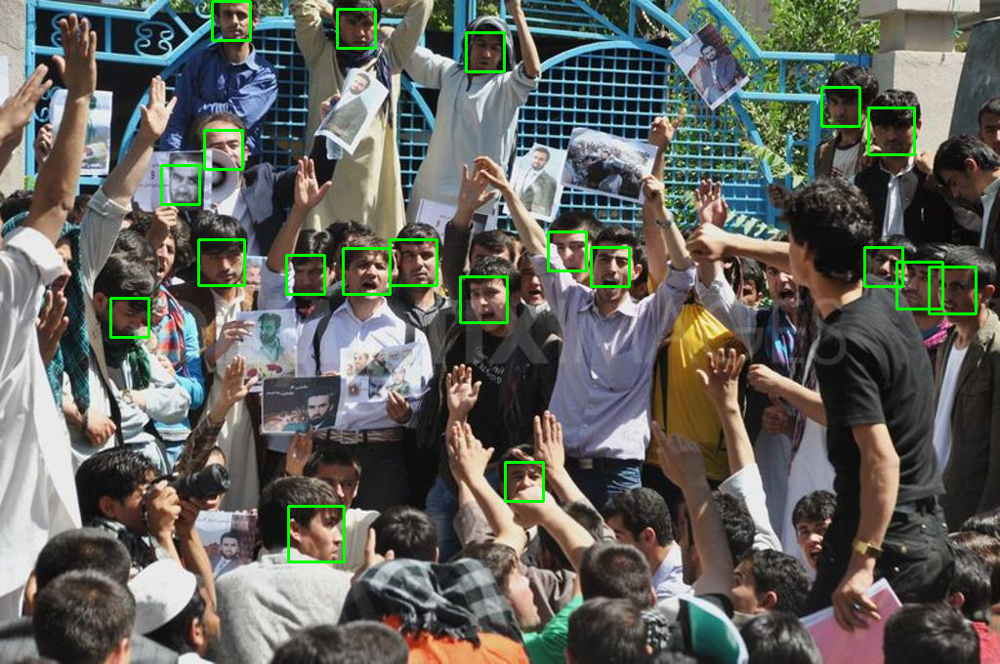

In [51]:
cnn_rects = cnn_detector(img_rgb, 1)

cnn_boxes = [convert_and_trim_bb(img, r.rect) for r in cnn_rects]

img_cnn = img.copy()
for (x, y, w, h) in cnn_boxes:
	cv2.rectangle(img_cnn, (x, y), (x + w, y + h), (0, 255, 0), 2)
 
cv2_imshow(img_cnn)

|Metoda |Ground Truth| TP | FN | FP |
|-------|------------|----|----|----|
|Haar   |     56     | 11 | 45 | 2  |
|HOG+SVM|     56     | 8  | 48 | 0  |
|CNN    |     56     | 20 | 36 | 0  |

# Obraz łatwy

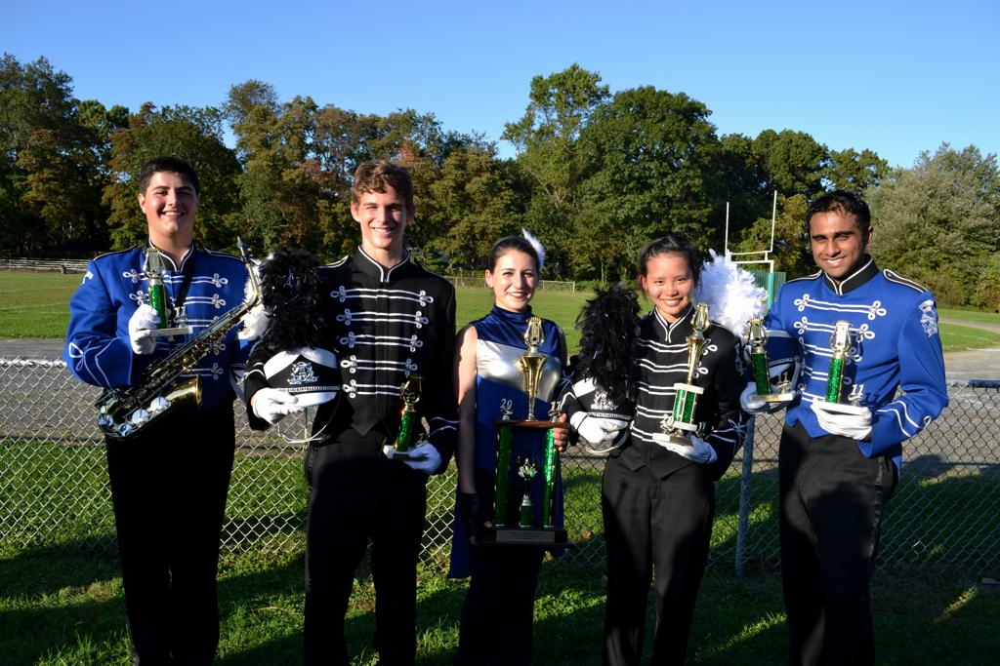

In [52]:
img = cv2.imread("/content/0_Parade_marchingband_1_95.jpg")
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

cv2_imshow(img)

## Kaskada Haara

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/05/opencv-face-detection-with-haar-cascades/

In [53]:
haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")

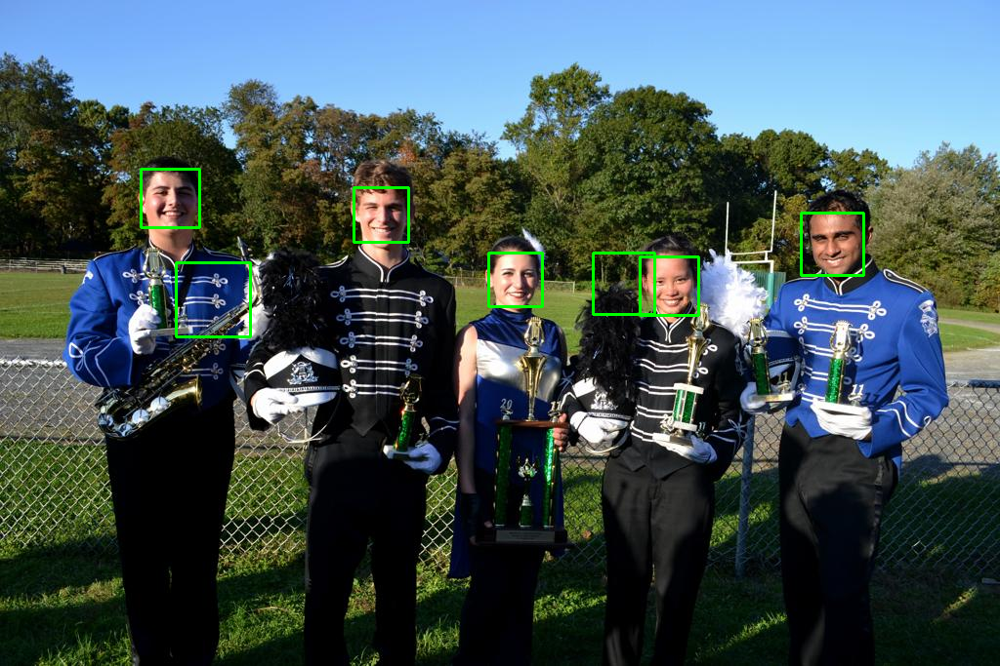

In [54]:
rects = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05,
	                                minNeighbors=5, minSize=(30, 30),
	                                flags=cv2.CASCADE_SCALE_IMAGE)

img_haar = img.copy()
for (x, y, w, h) in rects:
  cv2.rectangle(img_haar, (x, y), (x + w, y + h), (0, 255, 0), 2)
cv2_imshow(img_haar)


## Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [55]:
def convert_and_trim_bb(image, rect):
	# extract the starting and ending (x, y)-coordinates of the
	# bounding box
	startX = rect.left()
	startY = rect.top()
	endX = rect.right()
	endY = rect.bottom()
	# ensure the bounding box coordinates fall within the spatial
	# dimensions of the image
	startX = max(0, startX)
	startY = max(0, startY)
	endX = min(endX, image.shape[1])
	endY = min(endY, image.shape[0])
	# compute the width and height of the bounding box
	w = endX - startX
	h = endY - startY
	# return our bounding box coordinates
	return (startX, startY, w, h)

In [56]:
hog_svm_detector = dlib.get_frontal_face_detector()

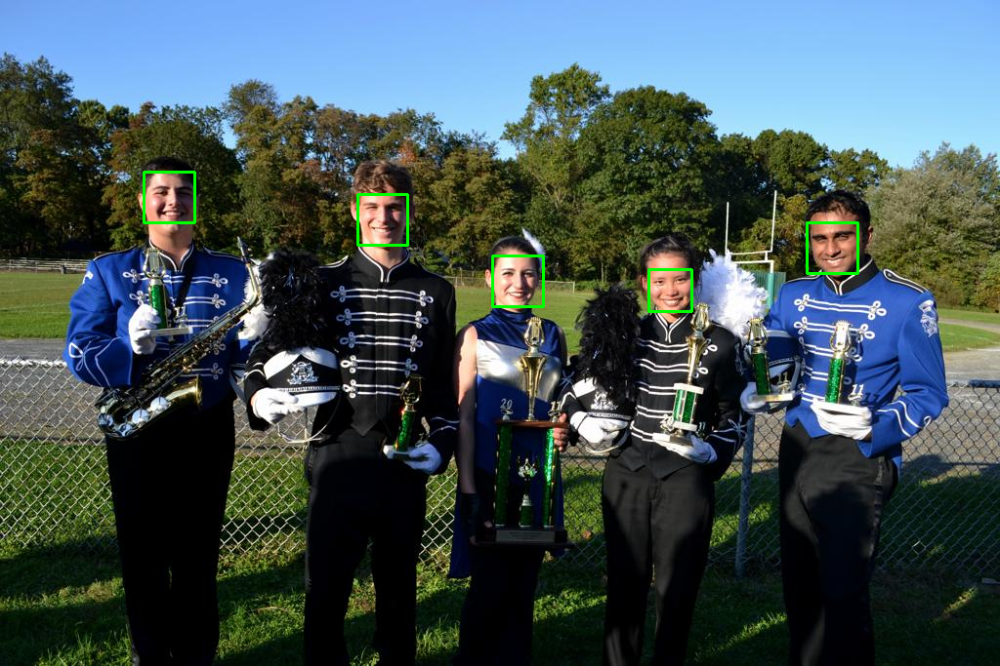

In [57]:
hog_svm_rects = hog_svm_detector(img_rgb, 1)

hog_svm_boxes = [convert_and_trim_bb(img, r) for r in hog_svm_rects]

img_hog_svm = img.copy()
for (x, y, w, h) in hog_svm_boxes:
	cv2.rectangle(img_hog_svm, (x, y), (x + w, y + h), (0, 255, 0), 2)
 
cv2_imshow(img_hog_svm)

## Splotowa sieć neuronowa (CNN)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [58]:
cnn_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')

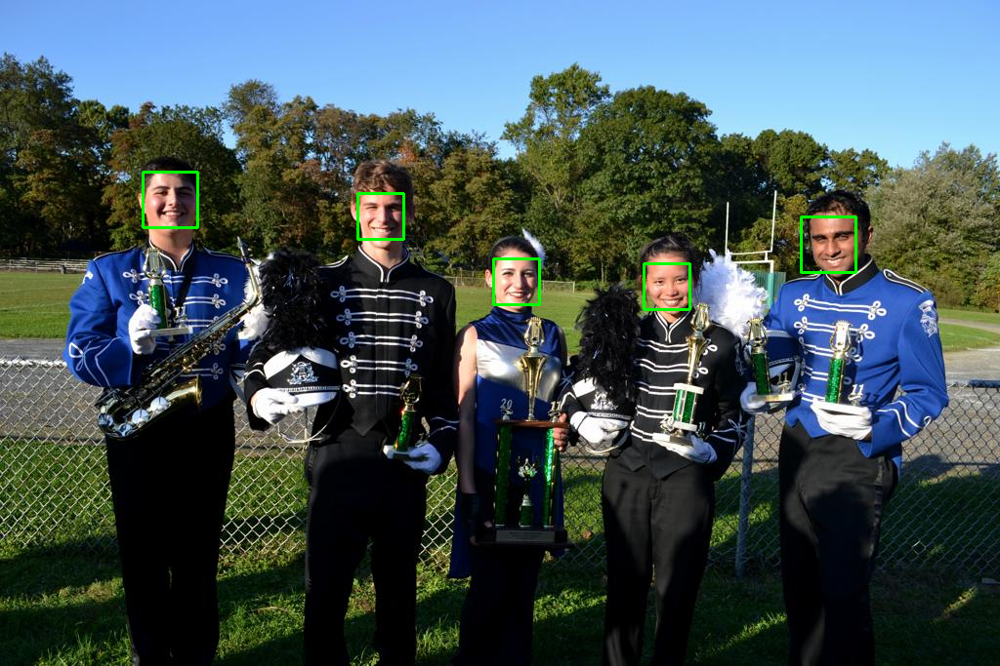

In [59]:
cnn_rects = cnn_detector(img_rgb, 1)

cnn_boxes = [convert_and_trim_bb(img, r.rect) for r in cnn_rects]

img_cnn = img.copy()
for (x, y, w, h) in cnn_boxes:
	cv2.rectangle(img_cnn, (x, y), (x + w, y + h), (0, 255, 0), 2)
 
cv2_imshow(img_cnn)

|Metoda |Ground Truth| TP | FN | FP |
|-------|------------|----|----|----|
|Haar   |     5      | 5  | 0  | 2  |
|HOG+SVM|     5      | 5  | 0  | 0  |
|CNN    |     5      | 5  | 0  | 0  |

# Obraz średni

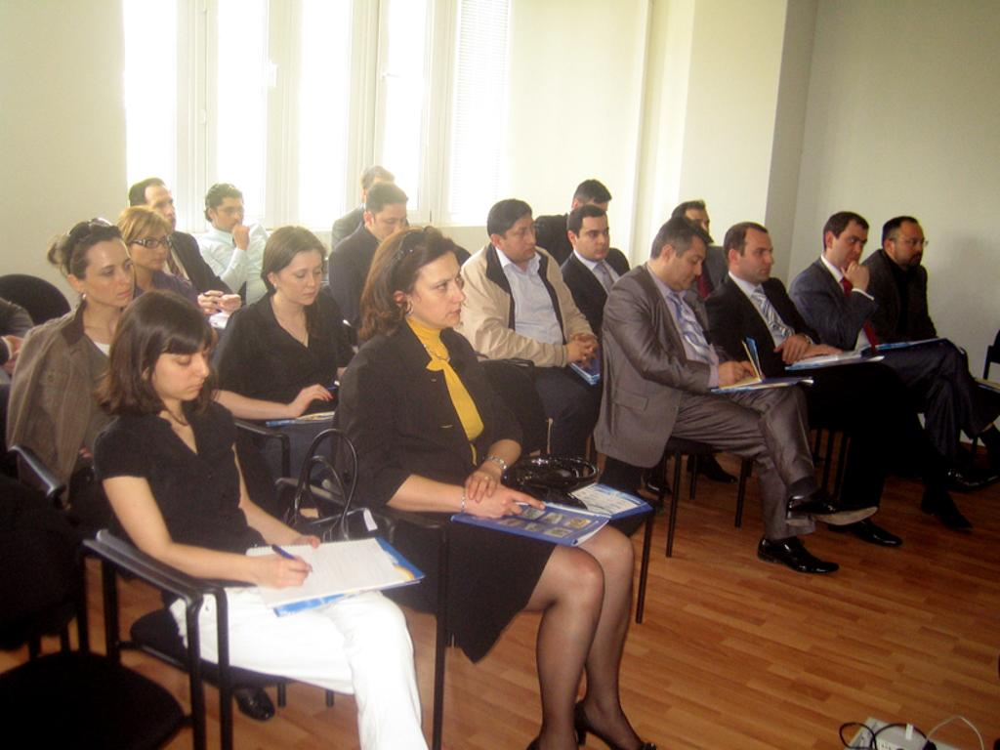

In [60]:
img = cv2.imread("/content/11_Meeting_Meeting_11_Meeting_Meeting_11_91.jpg")
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

cv2_imshow(img)

## Kaskada Haara

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/05/opencv-face-detection-with-haar-cascades/

In [61]:
haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")

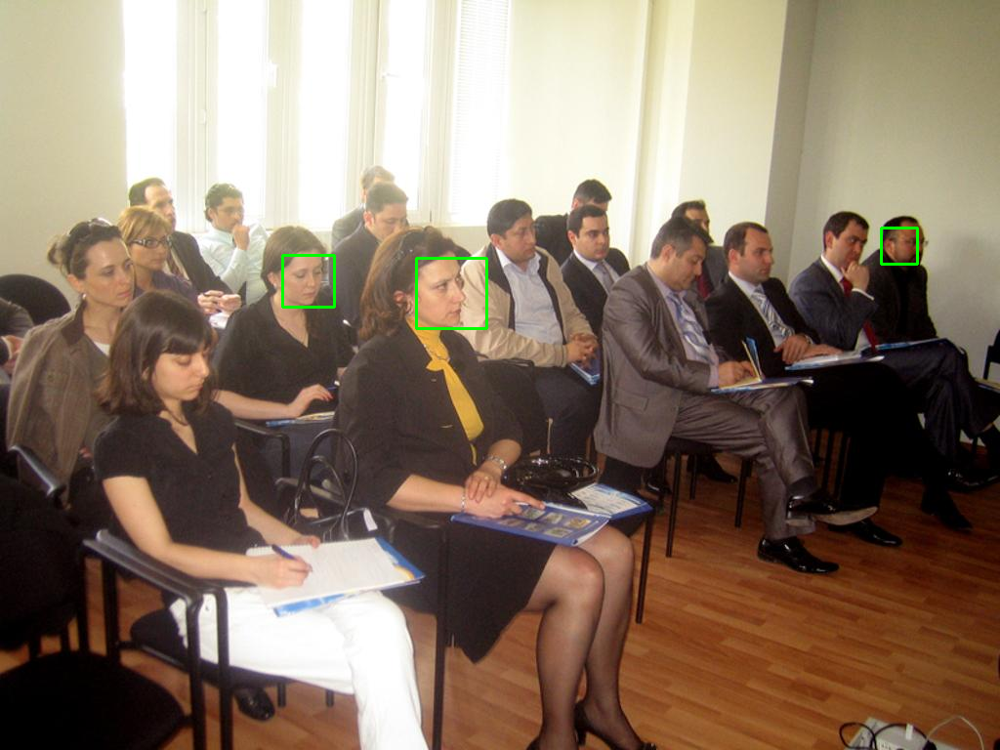

In [62]:
rects = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05,
	                                minNeighbors=5, minSize=(30, 30),
	                                flags=cv2.CASCADE_SCALE_IMAGE)

img_haar = img.copy()
for (x, y, w, h) in rects:
  cv2.rectangle(img_haar, (x, y), (x + w, y + h), (0, 255, 0), 2)
cv2_imshow(img_haar)


## Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [63]:
def convert_and_trim_bb(image, rect):
	# extract the starting and ending (x, y)-coordinates of the
	# bounding box
	startX = rect.left()
	startY = rect.top()
	endX = rect.right()
	endY = rect.bottom()
	# ensure the bounding box coordinates fall within the spatial
	# dimensions of the image
	startX = max(0, startX)
	startY = max(0, startY)
	endX = min(endX, image.shape[1])
	endY = min(endY, image.shape[0])
	# compute the width and height of the bounding box
	w = endX - startX
	h = endY - startY
	# return our bounding box coordinates
	return (startX, startY, w, h)

In [64]:
hog_svm_detector = dlib.get_frontal_face_detector()

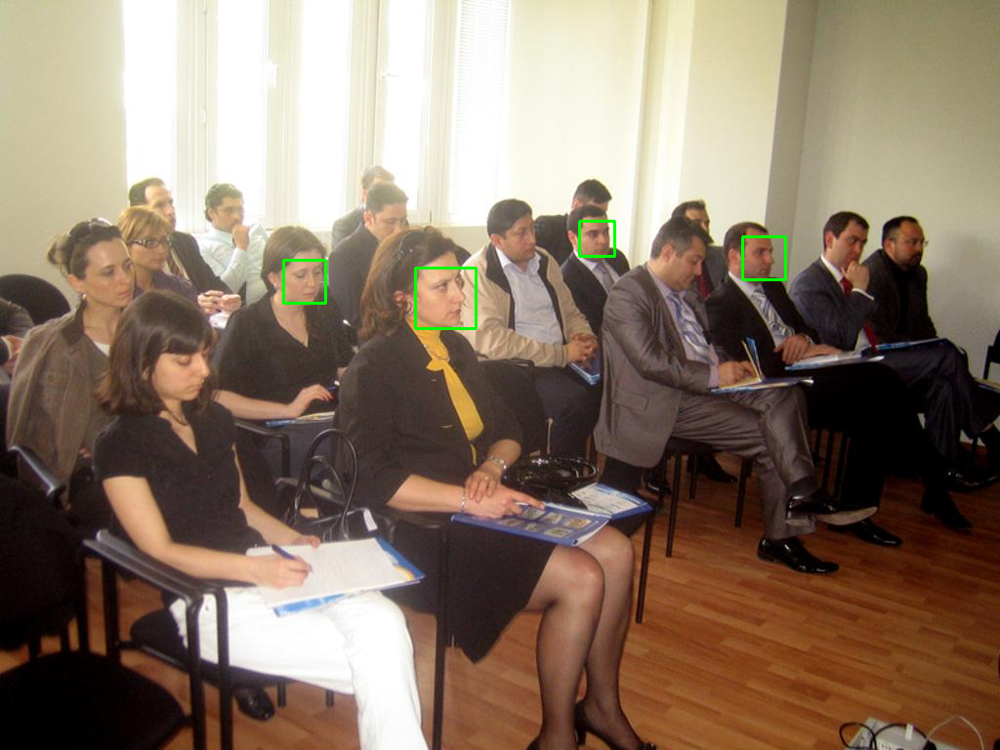

In [65]:
hog_svm_rects = hog_svm_detector(img_rgb, 1)

hog_svm_boxes = [convert_and_trim_bb(img, r) for r in hog_svm_rects]

img_hog_svm = img.copy()
for (x, y, w, h) in hog_svm_boxes:
	cv2.rectangle(img_hog_svm, (x, y), (x + w, y + h), (0, 255, 0), 2)
 
cv2_imshow(img_hog_svm)

## Splotowa sieć neuronowa (CNN)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [66]:
cnn_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')

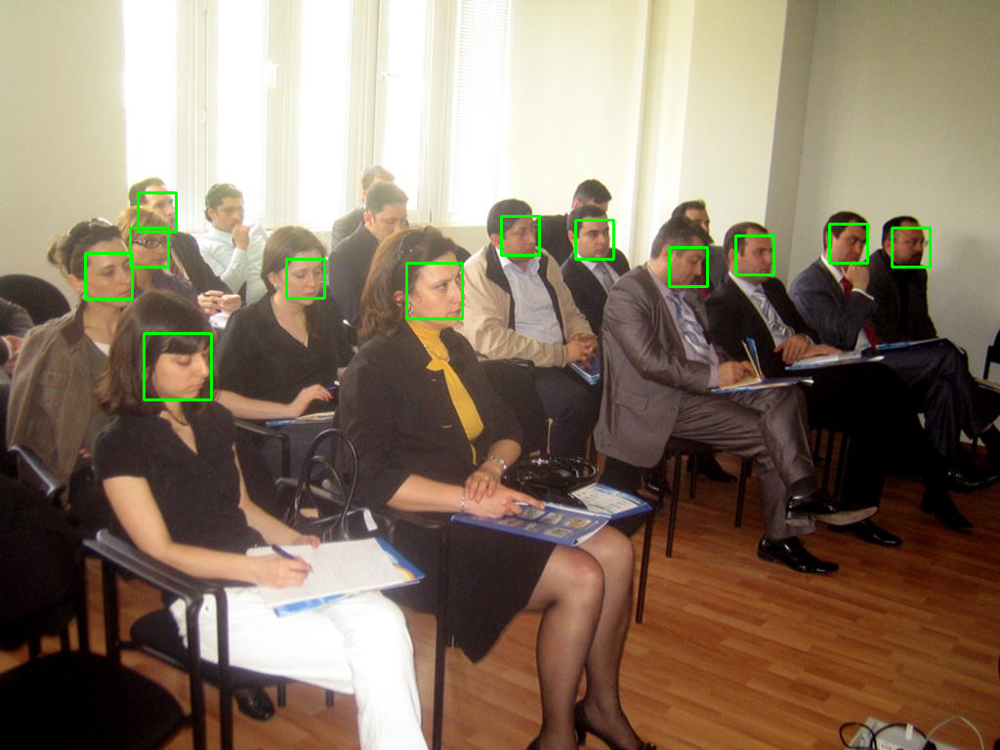

In [67]:
cnn_rects = cnn_detector(img_rgb, 1)

cnn_boxes = [convert_and_trim_bb(img, r.rect) for r in cnn_rects]

img_cnn = img.copy()
for (x, y, w, h) in cnn_boxes:
	cv2.rectangle(img_cnn, (x, y), (x + w, y + h), (0, 255, 0), 2)
 
cv2_imshow(img_cnn)

|Metoda |Ground Truth| TP | FN | FP |
|-------|------------|----|----|----|
|Haar   |    16      | 3  | 12 | 0  |
|HOG+SVM|    16      | 4  | 12 | 0  |
|CNN    |    16      | 12 | 4  | 0  |

# Obraz trudny

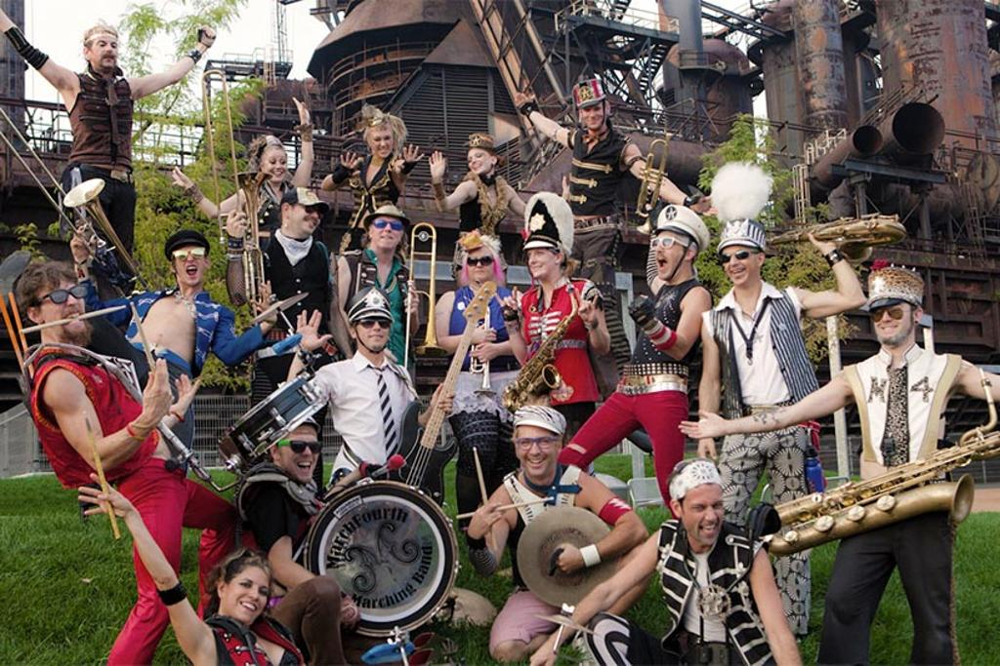

In [68]:
img = cv2.imread("/content/0_Parade_marchingband_1_31.jpg")
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

cv2_imshow(img)

## Kaskada Haara

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/05/opencv-face-detection-with-haar-cascades/

In [69]:
haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")

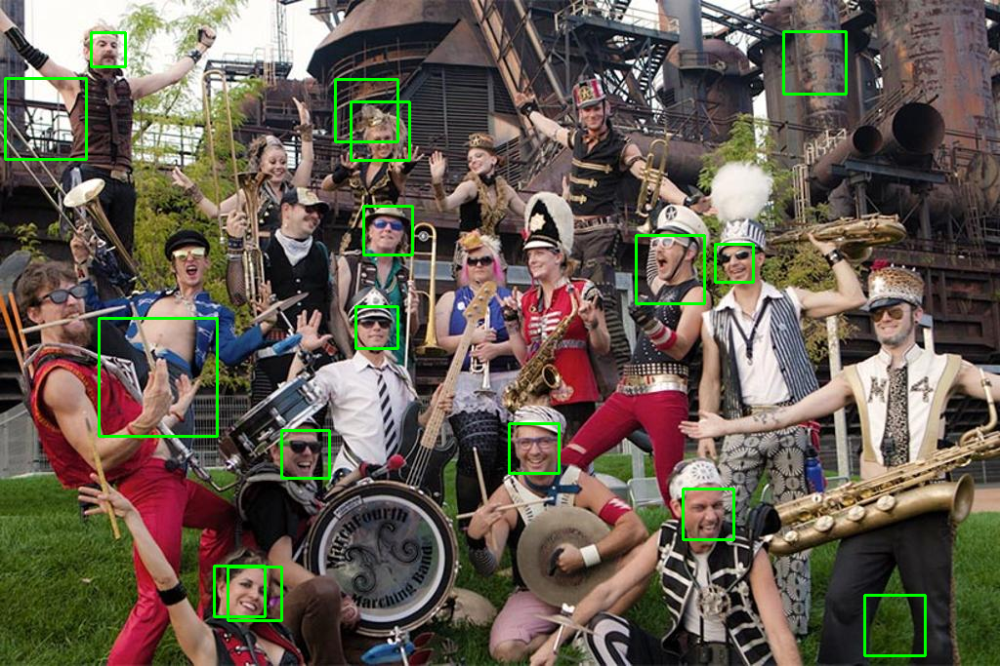

In [70]:
rects = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05,
	                                minNeighbors=5, minSize=(30, 30),
	                                flags=cv2.CASCADE_SCALE_IMAGE)

img_haar = img.copy()
for (x, y, w, h) in rects:
  cv2.rectangle(img_haar, (x, y), (x + w, y + h), (0, 255, 0), 2)
cv2_imshow(img_haar)


## Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [71]:
def convert_and_trim_bb(image, rect):
	# extract the starting and ending (x, y)-coordinates of the
	# bounding box
	startX = rect.left()
	startY = rect.top()
	endX = rect.right()
	endY = rect.bottom()
	# ensure the bounding box coordinates fall within the spatial
	# dimensions of the image
	startX = max(0, startX)
	startY = max(0, startY)
	endX = min(endX, image.shape[1])
	endY = min(endY, image.shape[0])
	# compute the width and height of the bounding box
	w = endX - startX
	h = endY - startY
	# return our bounding box coordinates
	return (startX, startY, w, h)

In [72]:
hog_svm_detector = dlib.get_frontal_face_detector()

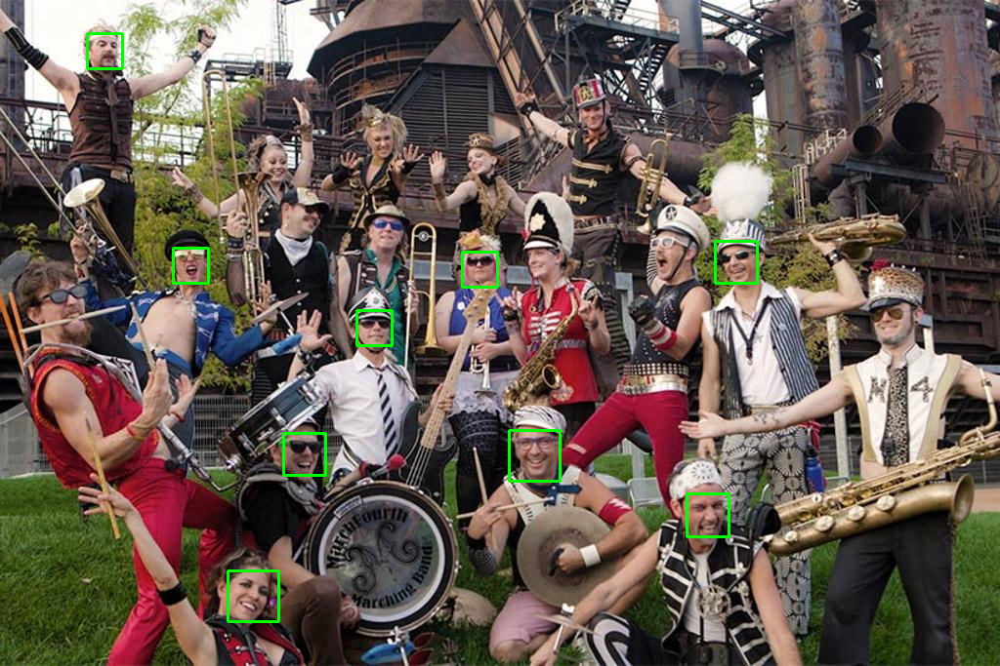

In [73]:
hog_svm_rects = hog_svm_detector(img_rgb, 1)

hog_svm_boxes = [convert_and_trim_bb(img, r) for r in hog_svm_rects]

img_hog_svm = img.copy()
for (x, y, w, h) in hog_svm_boxes:
	cv2.rectangle(img_hog_svm, (x, y), (x + w, y + h), (0, 255, 0), 2)
 
cv2_imshow(img_hog_svm)

## Splotowa sieć neuronowa (CNN)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [74]:
cnn_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')

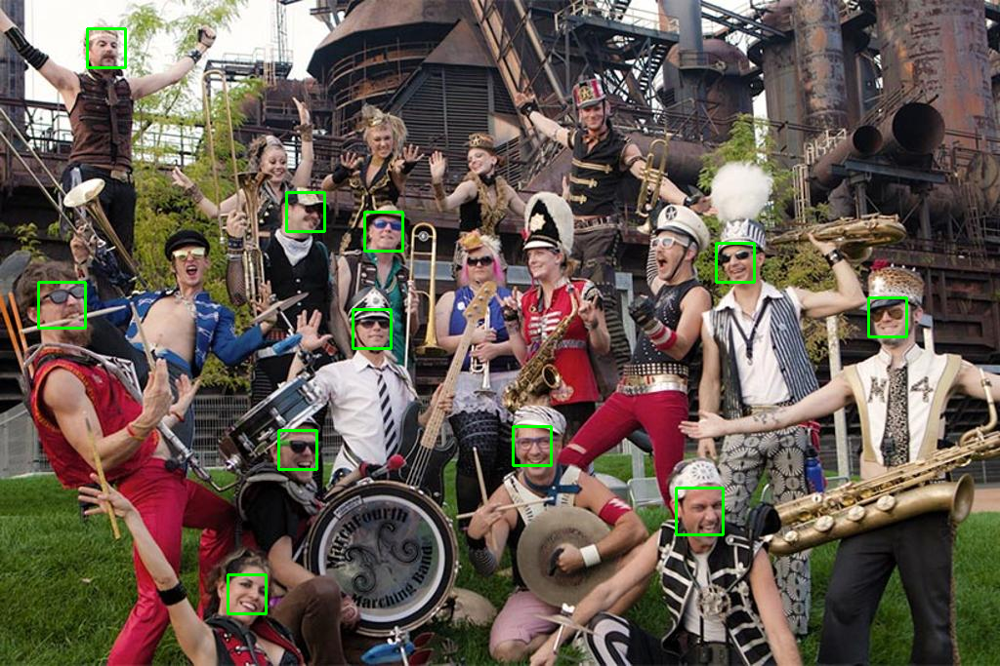

In [75]:
cnn_rects = cnn_detector(img_rgb, 1)

cnn_boxes = [convert_and_trim_bb(img, r.rect) for r in cnn_rects]

img_cnn = img.copy()
for (x, y, w, h) in cnn_boxes:
	cv2.rectangle(img_cnn, (x, y), (x + w, y + h), (0, 255, 0), 2)
 
cv2_imshow(img_cnn)

|Metoda |Ground Truth| TP | FN | FP |
|-------|------------|----|----|----|
|Haar   |    19      | 10 | 9  | 6  |
|HOG+SVM|    19      | 9  | 10 | 0  |
|CNN    |    19      | 11 | 5  | 0  |

# Suma podejść

|Algorytm| GT | TP | FN | FP |
|--------|----|----|----|----|
|Haar    | 96 | 29 | 66 | 10 |
|HOG+SVM | 96 | 26 | 70 |  0 |
|CNN     | 96 | 48 | 45 |  0 |

# Czas wykonania

In [76]:
runs = []
imgs = ["/content/2_Demonstration_Demonstration_Or_Protest_2_1.jpg", "/content/0_Parade_marchingband_1_95.jpg", "/content/11_Meeting_Meeting_11_Meeting_Meeting_11_91.jpg", "/content/0_Parade_marchingband_1_31.jpg"]

for img in imgs:
  cur_run = []
  cur_img = cv2.imread(img)
  img_gray = cv2.cvtColor(cur_img, cv2.COLOR_BGR2GRAY)
  img_rgb = cv2.cvtColor(cur_img, cv2.COLOR_BGR2RGB)

  # Haar
  start = time.time()
  haar_detector.detectMultiScale(img_gray, scaleFactor=1.05,
	                                minNeighbors=5, minSize=(30, 30),
	                                flags=cv2.CASCADE_SCALE_IMAGE)
  end = time.time()
  cur_run.append(end-start)
  
  # HOG+SVM
  start = time.time()
  hog_svm_detector(img_rgb, 1)
  end = time.time()
  cur_run.append(end-start)
  
  # CNN
  start = time.time()
  cnn_detector(img_rgb, 1)
  end = time.time()
  cur_run.append(end-start)

  runs.append(cur_run)

img_time = [0, 0, 0]
for run in runs:
  for idx, _ in enumerate(run):
    img_time[idx] += run[idx]

print("====================================")
print(f"|| Haar total: {img_time[0]}")
print(f"|| HOG+SVM total: {img_time[1]}")
print(f"|| CNN total: {img_time[2]}")
print("====================================")
  

|| Haar total: 3.542787790298462
|| HOG+SVM total: 1.9246556758880615
|| CNN total: 0.8363699913024902


# Wnioski

Kaskada Haara jest najłatwiejszy do oszukania przez losowo występujące kontrasty w naturze. Skutkuje to większą od innych metod ilością FP.

HOG z SVM raczej nie wskazuje FP, ale przekłada się to na większą ilość FN, co również psuje wyniki.

Z kolei CNN jest w stanie rozpoznać łącznie nawet połowę wszystkich twarzy, a do tego nie podał ani razu żadnego FP, co czyni go ewidentnym zwycięzcą w tym porównaniu.


W kwestii czasu wykonywania, CNN jest najszybsza, a Haar najwolniejszy, choć wynika to prawdopodobnie z optymalizacji na GPU, wykorzystywanych w Google Colab.